In [1]:
%cd ..
%load_ext autoreload
%autoreload 2

/Users/danieloliveiradebrito/Projetos/fakenews


/Users/danieloliveiradebrito/Projetos/fakenews/.venv/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
import polars as pl
from fakenews.read_data import read_fakebr_corpus

fake_news = read_fakebr_corpus("data/fakebr-corpus/fake/*.txt")
true_news = read_fakebr_corpus("data/fakebr-corpus/true/*.txt")

pl.concat([fake_news, true_news]).write_parquet("data/fakebr-corpus.zstd", compression="zstd")

# Embeddings

## Embeda

In [4]:
from sentence_transformers import SentenceTransformer

model = SentenceTransformer("sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2")

/Users/danieloliveiradebrito/Projetos/fakenews/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [93]:
mini_lm_embedding = (
    pl.scan_parquet("data/fakebr-corpus.zstd")
    .with_columns(
        pl.col("texts").map_elements(lambda x: model.encode(x).tolist(),
                                     return_dtype=pl.List(pl.Float64)
                                     ).alias("embedding"))
    .collect()
 )

In [94]:
mini_lm_embedding.write_parquet("data/fakebr-corpus-embedding.zstd", compression="zstd")

## Projeta

In [4]:
import numpy as np
import polars as pl

X_emb_array = np.array(pl.scan_parquet("data/fakebr-corpus-embedding.zstd").select("embedding").collect().to_series().to_list())
labels = pl.scan_parquet("data/fakebr-corpus-embedding.zstd").select("label").collect()

In [5]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=15, random_state=42)
X = tsne.fit_transform(X_emb_array)

## Plota

In [7]:
import altair as alt

figure = (alt.Chart(pl.concat([pl.DataFrame(X), labels], how="horizontal").sample(5_000),
           title=alt.Title(
               "t-SNE projection of the embeddings of the FakeBR corpus",
               subtitle="paraphrase-multilingual-MiniLM-L12-v2 embedding",
               anchor="start"
           ))
 .encode(
     x=alt.X("column_0", title="t-SNE 1"),
     y=alt.Y("column_1", title="t-SNE 2"),
     color=alt.Color("label:N", title="Label (is Fake)",
                     scale=alt.Scale(domain=[1, 0],
                                     range=["#D53F3A", "#0F428A"])),
     opacity=alt.value(0.6)
 )
 .mark_circle(size=40)
 .properties(width=300, height=300)
 #.configure_view(stroke=None)
 .configure_axis(grid=False)
 )

figure.save("reports/figures/tsne-embedding-fakebr.png", ppi=300)

# Algum termo "entrega"? 

## Nuvem de palavaras

In [4]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import nltk

In [15]:
stop_words = set(stopwords.words("portuguese"))

texto_fake = (pl.read_parquet("data/fakebr-corpus.zstd")
           .filter(pl.col("label") == 1)
           .select("texts")
           .to_series()
           .to_list()
        )

full_text_fake = ""
for noticia in texto_fake:
    full_text_fake += noticia.lower() + " "

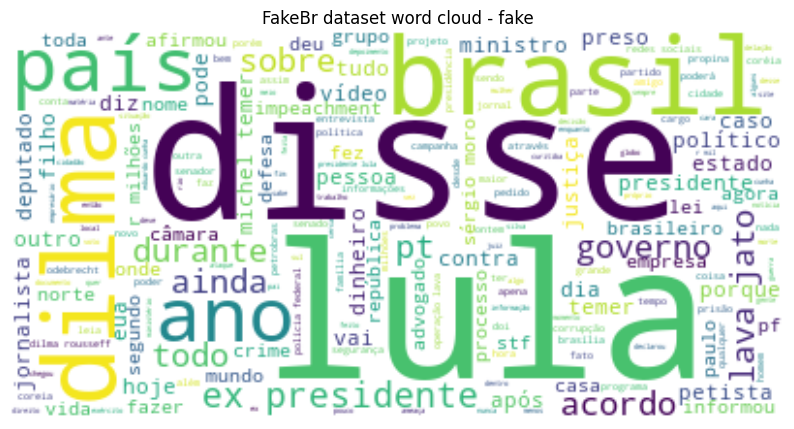

In [17]:
wc = WordCloud(background_color="white",
               stopwords=list(stop_words)).generate(full_text_fake)
plt.figure(figsize=(10, 10))
plt.title("FakeBr dataset word cloud - fake")
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

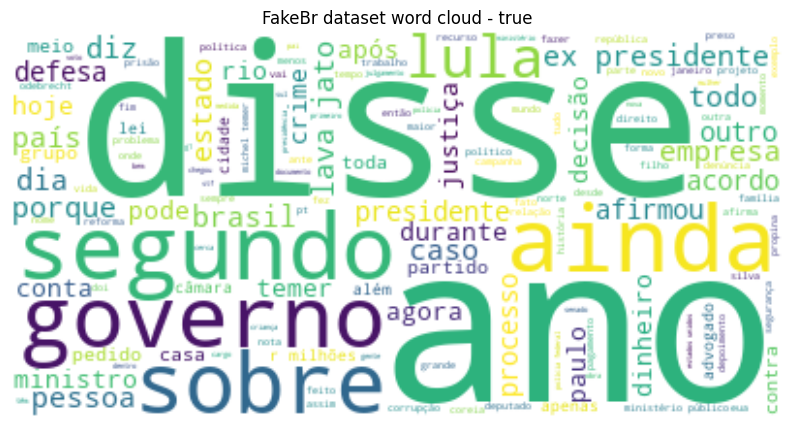

In [118]:
stop_words = set(stopwords.words("portuguese"))

texto_true = (pl.read_parquet("data/fakebr-corpus.zstd")
           .filter(pl.col("label") == 0)
           .select("texts")
           .to_series()
           .to_list()
        )

full_text = ""
for noticia in texto_true:
    full_text += noticia.lower() + " "

wc = WordCloud(background_color="white",
               stopwords=list(stop_words)).generate(full_text)
plt.figure(figsize=(10, 10))
plt.title("FakeBr dataset word cloud - true")
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

## Feature Importance

In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

df = (pl.read_parquet("data/fakebr-corpus.zstd")
 .select(["texts", "label"])
 .rename({"texts": "text"})
 .to_pandas()
)

train, test = train_test_split(df,
                              test_size=0.2,
                              random_state=42,
                              shuffle=True,
                              stratify=df["label"]
                            )

tfidf = TfidfVectorizer(
    lowercase=True,
    stop_words=stopwords.words("portuguese"),
    max_features=512)
X_train = tfidf.fit_transform(train["text"])
X_test = tfidf.transform(test["text"])

y_train, y_test = train["label"], test["label"]

In [34]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

accuracy_score(y_test, y_pred)

0.9659722222222222

In [35]:
X_train.shape

(5760, 512)

In [37]:
y_pred.mean()

0.4951388888888889

In [38]:
import altair as alt

importances = rf.feature_importances_
features = tfidf.get_feature_names_out()

ft_imp = pl.DataFrame(
    dict(
        feature = features,
        importance = importances
    )
).sort("importance", descending=True)

ft_imp_plot = alt.Chart(ft_imp.head(20),
          title=alt.Title("Feature Importance - Random Forest",
                          subtitle="Fakerecogna dataset",
                          anchor="start")).mark_bar().encode(
    x=alt.X("importance:Q", title="Importance"),
    y=alt.Y("feature:N", title="Feature").sort("-x")
)

ft_imp_plot.save("reports/figures/feature-importance-fakebr.png", ppi=300)

In [39]:
ft_imp_plot

alt.Chart(...)

In [50]:
texto = "nesta segunda-feira foi identificado segundo a polícia federal que o presidente da república é um alienígena"
rf.predict_proba(tfidf.transform([texto]))

array([[0.59, 0.41]])

In [52]:
texto_lula = """Luiz Inácio Lula da Silva (nascido Luiz Inácio da Silva;[nota 2] Garanhuns,[nota 3] 27 de outubro de 1945), mais conhecido como Lula, é um ex-metalúrgico, ex-sindicalista e político brasileiro, filiado ao Partido dos Trabalhadores (PT). É o 39.º presidente do Brasil desde 2023, além de ter sido o 35.º presidente da República entre 2003 e 2011.

De origem pobre, migrou ainda criança de Pernambuco para São Paulo com sua família. Foi metalúrgico e sindicalista, época em que recebeu a alcunha "Lula", forma hipocorística de "Luís". Durante a ditadura militar, liderou grandes greves de operários no ABC Paulista e ajudou a fundar o PT em 1980, durante o processo de abertura política. Lula foi uma das principais lideranças do movimento Diretas Já, no período da redemocratização, quando iniciou sua carreira política. Elegeu-se em 1986 deputado federal pelo estado de São Paulo com votação recorde. Em 1989 concorreu pela primeira vez à presidência da República, perdendo no segundo turno para Fernando Collor de Mello. Foi candidato a presidente por outras duas vezes, em 1994 e em 1998, perdendo ambas as eleições no primeiro turno para Fernando Henrique Cardoso. Venceu a eleição presidencial de 2002, derrotando José Serra no segundo turno. Na eleição de 2006, foi reeleito ao superar Geraldo Alckmin no segundo turno."""

rf.predict_proba(tfidf.transform([texto_lula.lower()]))

array([[0.44, 0.56]])

In [66]:
df_len = (pl.read_parquet("data/fakebr-corpus.zstd")
          .with_columns(pl.col("texts").str.len_bytes().alias("len"))
          )

alt.Chart(df_len.sample(5_000),
          title=alt.Title(
            "Length of the news in the FakeBR dataset",
            anchor="start"
          )).encode(
    y=alt.Y("len:Q", title="Text length"),
    x=alt.X("label:N", title="Label"),
    color=alt.Color("label:N", title="Label (is Fake)",
                     scale=alt.Scale(domain=[1, 0],
                                     range=["#D53F3A", "#0F428A"])),
).mark_boxplot().properties(width=300, height=300)

alt.Chart(...)

## Normalizando tamanho

In [5]:
from fakenews.read_data import read_fakebr_corpus

normalized_fake = read_fakebr_corpus("data/fakebr-corpus/size_normalized_texts/fake/*.txt")
normalized_true = read_fakebr_corpus("data/fakebr-corpus/size_normalized_texts/true/*.txt")

normalized_df = pl.concat([normalized_fake, normalized_true])

### Embedding

In [9]:
mini_normalized_lm_embedding = (
    normalized_df.lazy()
    .with_columns(
        pl.col("texts").map_elements(lambda x: model.encode(x).tolist(),
                                     return_dtype=pl.List(pl.Float64)
                                     ).alias("embedding"))
    .collect()
 )

In [10]:
mini_normalized_lm_embedding.write_parquet("data/fakebr-corpus-normalized-embedding.zstd", compression="zstd")

### Projeta

In [13]:
import numpy as np
X_emb_array = np.array(
    pl.scan_parquet("data/fakebr-corpus-normalized-embedding.zstd").select("embedding").collect().to_series().to_list()
)
labels = pl.scan_parquet("data/fakebr-corpus-normalized-embedding.zstd").select("label").collect()

from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=15, random_state=42)
X = tsne.fit_transform(X_emb_array)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [15]:
import altair as alt

figure = (alt.Chart(pl.concat([pl.DataFrame(X), labels], how="horizontal").sample(5_000),
           title=alt.Title(
               "t-SNE projection of the embeddings of the FakeBR corpus",
               subtitle="paraphrase-multilingual-MiniLM-L12-v2 embedding",
               anchor="start"
           ))
 .encode(
     x=alt.X("column_0", title="t-SNE 1"),
     y=alt.Y("column_1", title="t-SNE 2"),
     color=alt.Color("label:N", title="Label (is Fake)",
                     scale=alt.Scale(domain=[1, 0],
                                     range=["#D53F3A", "#0F428A"])),
     opacity=alt.value(0.6)
 )
 .mark_circle(size=40)
 .properties(width=300, height=300)
 #.configure_view(stroke=None)
 .configure_axis(grid=False)
 )

figure.save("reports/figures/fakebr-normalized-tsne-embedding.png", ppi=300)

### Wordcloud

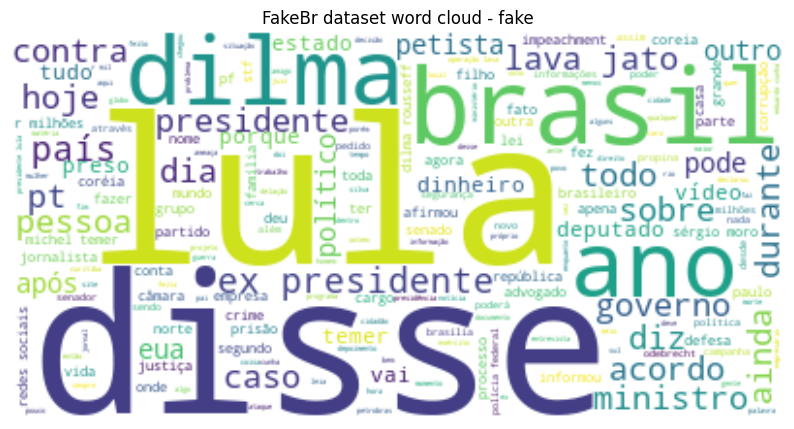

In [16]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import nltk

stop_words = set(stopwords.words("portuguese"))

texto_fake = (normalized_df
           .filter(pl.col("label") == 1)
           .select("texts")
           .to_series()
           .to_list()
        )

full_text_fake = ""
for noticia in texto_fake:
    full_text_fake += noticia.lower() + " "

wc = WordCloud(background_color="white",
               stopwords=list(stop_words)).generate(full_text_fake)
plt.figure(figsize=(10, 10))
plt.title("FakeBr dataset word cloud - fake")
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

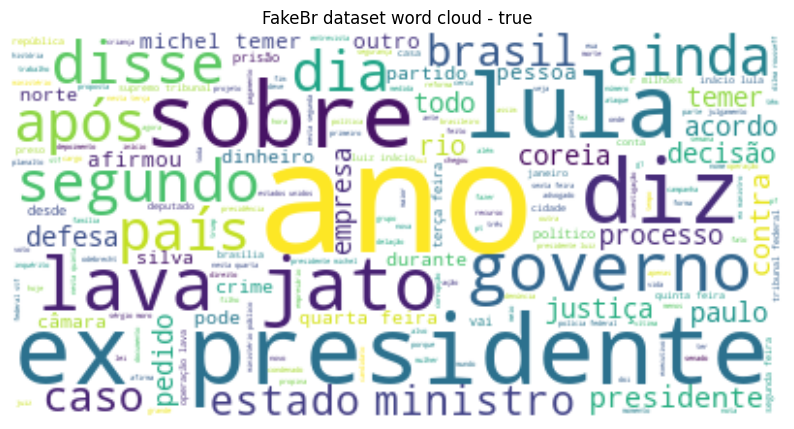

In [17]:
stop_words = set(stopwords.words("portuguese"))

texto_true = (normalized_df
           .filter(pl.col("label") == 0)
           .select("texts")
           .to_series()
           .to_list()
        )

full_text = ""
for noticia in texto_true:
    full_text += noticia.lower() + " "

wc = WordCloud(background_color="white",
               stopwords=list(stop_words)).generate(full_text)
plt.figure(figsize=(10, 10))
plt.title("FakeBr dataset word cloud - true")
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

### Feature Importance

In [21]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

df = (normalized_df
 .select(["texts", "label"])
 .rename({"texts": "text"})
 .to_pandas()
)

train, test = train_test_split(df,
                              test_size=0.2,
                              random_state=42,
                              shuffle=True,
                              stratify=df["label"]
                            )

tfidf = TfidfVectorizer(
    lowercase=True,
    stop_words=stopwords.words("portuguese"),
    max_features=512)
X_train = tfidf.fit_transform(train["text"])
X_test = tfidf.transform(test["text"])

y_train, y_test = train["label"], test["label"]

In [22]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

accuracy_score(y_test, y_pred)

0.8638888888888889

In [77]:
import altair as alt

importances = rf.feature_importances_
features = tfidf.get_feature_names_out()

ft_imp = pl.DataFrame(
    dict(
        feature = features,
        importance = importances
    )
).sort("importance", descending=True)

ft_imp_plot = alt.Chart(ft_imp.head(20),
          title=alt.Title("Feature Importance - Random Forest",
                          subtitle="Normalized fakerecogna dataset",
                          anchor="start")).mark_bar().encode(
    x=alt.X("importance:Q", title="Importance"),
    y=alt.Y("feature:N", title="Feature").sort("-x")
)
ft_imp_plot

alt.Chart(...)

In [80]:
df_len = (normalized_df
          .with_columns(pl.col("texts").str.len_bytes().alias("len"))
          )

alt.Chart(df_len.sample(5_000),
          title=alt.Title(
            "Length of the news in the normalized FakeBR dataset",
            anchor="start"
          )).encode(
    y=alt.Y("len:Q", title="Text length"),
    x=alt.X("label:N", title="Label"),
    color=alt.Color("label:N", title="Label (is Fake)",
                     scale=alt.Scale(domain=[1, 0],
                                     range=["#D53F3A", "#0F428A"])),
).mark_boxplot().properties(width=300, height=300)

alt.Chart(...)

In [23]:
rf.predict_proba(tfidf.transform([("lula foi eleito")]))

array([[0.17, 0.83]])

In [24]:
rf.predict_proba(tfidf.transform([("joão foi eleito")]))

array([[0.75, 0.25]])